In [1]:
import cv2
import numpy as np
import pandas as pd

In [2]:
import matplotlib.pyplot as plt
from PIL import Image

In [3]:
def show(img):
    import cv2
    import IPython
    _,ret = cv2.imencode('.jpg', img) 
    i = IPython.display.Image(data=ret)
    IPython.display.display(i)

In [4]:
img = cv2.imread('fp2.png')

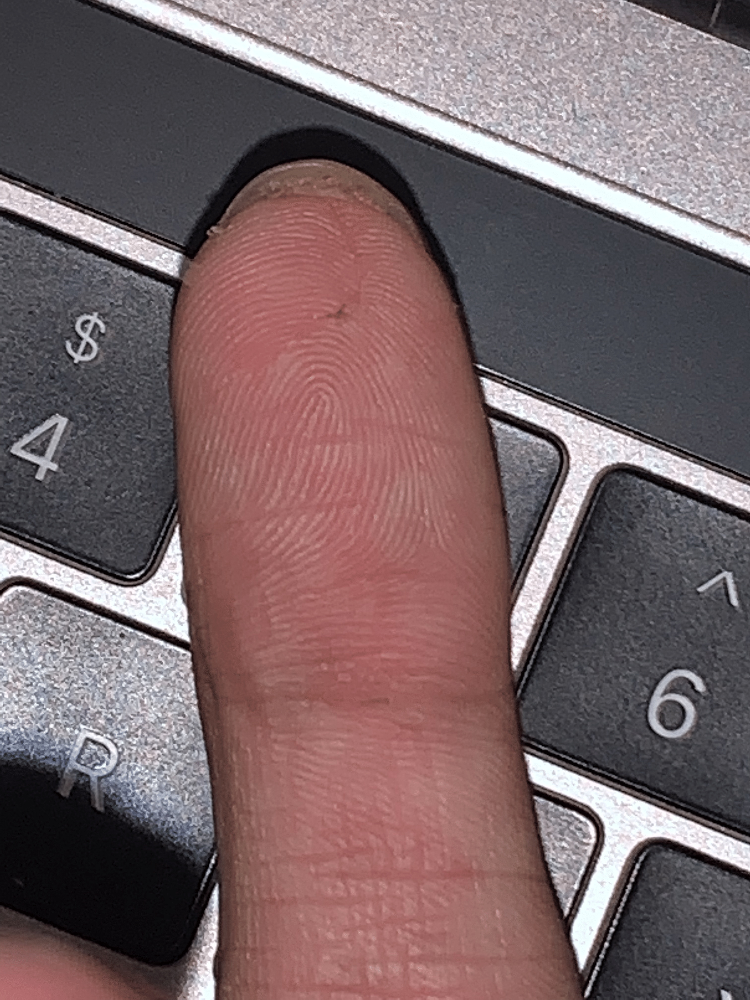

In [5]:
show(img)

In [6]:
img.shape

(4032, 3024, 3)

In [7]:
bnw_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

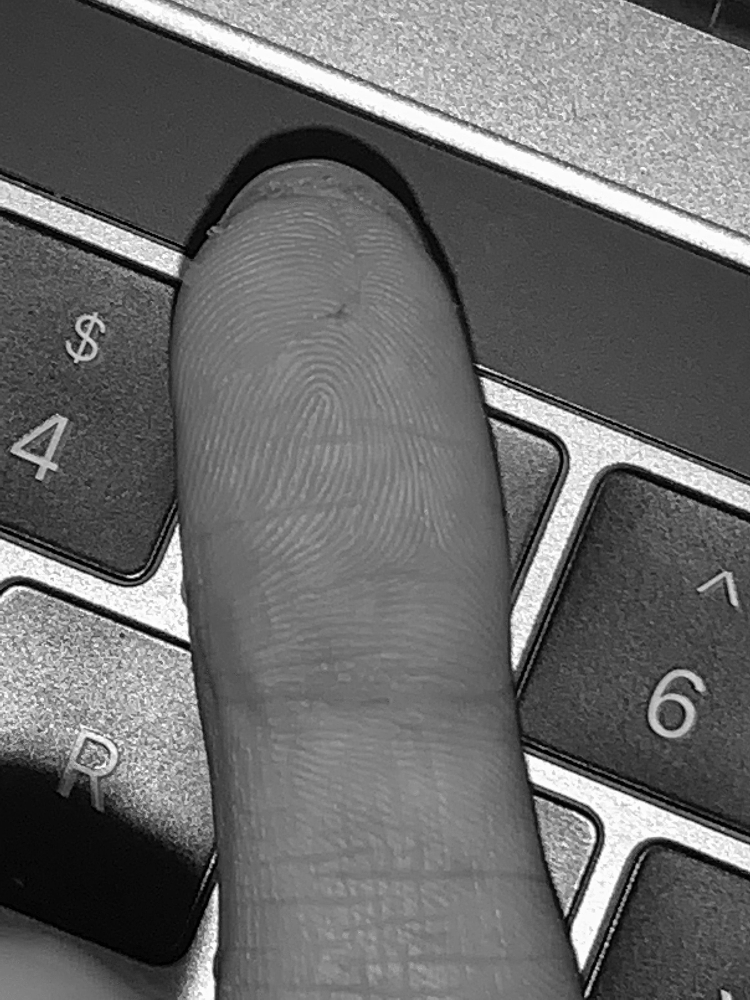

In [8]:
show(bnw_img)

In [9]:
th =  cv2.adaptiveThreshold(bnw_img,255,cv2.ADAPTIVE_THRESH_GAUSSIAN_C,cv2.THRESH_BINARY,3,2)

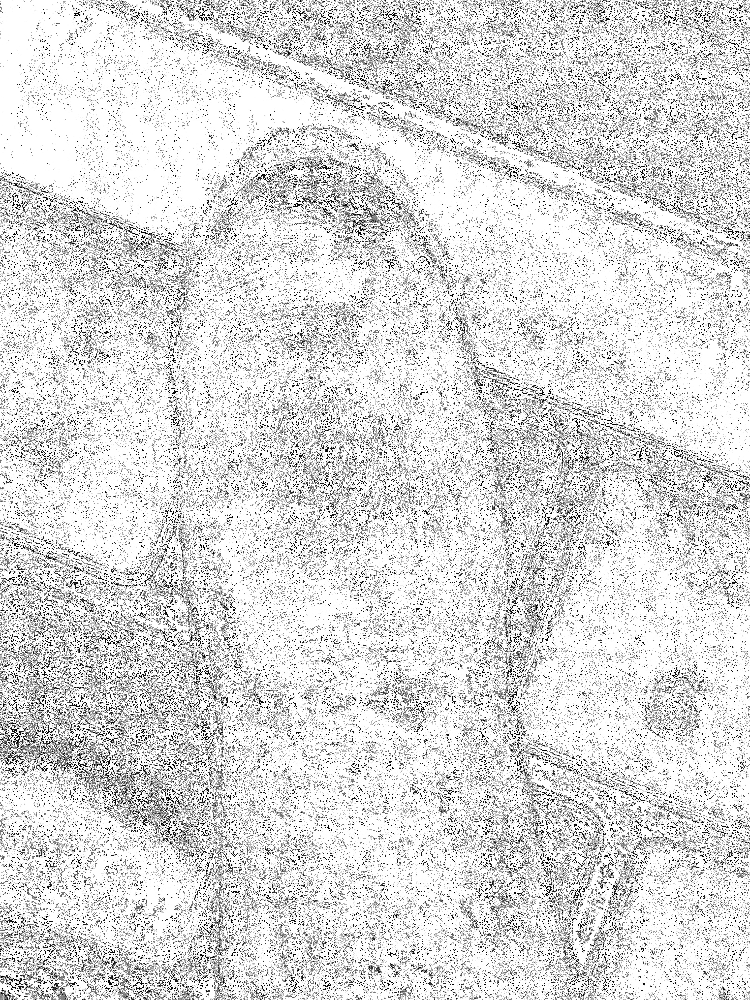

In [10]:
show(th)

In [11]:
se=cv2.getStructuringElement(cv2.MORPH_RECT , (8,8))
bg=cv2.morphologyEx(bnw_img, cv2.MORPH_DILATE, se)
out_gray=cv2.divide(bnw_img, bg, scale=255)
out_binary=cv2.threshold(out_gray, 0, 255, cv2.THRESH_OTSU )

In [12]:
out_binary = np.array(out_binary)

/var/folders/dm/1hcwyfgn3cj_bbdzd7mv28dw0000gn/T/ipykernel_17526/4261139866.py:1: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  out_binary = np.array(out_binary)


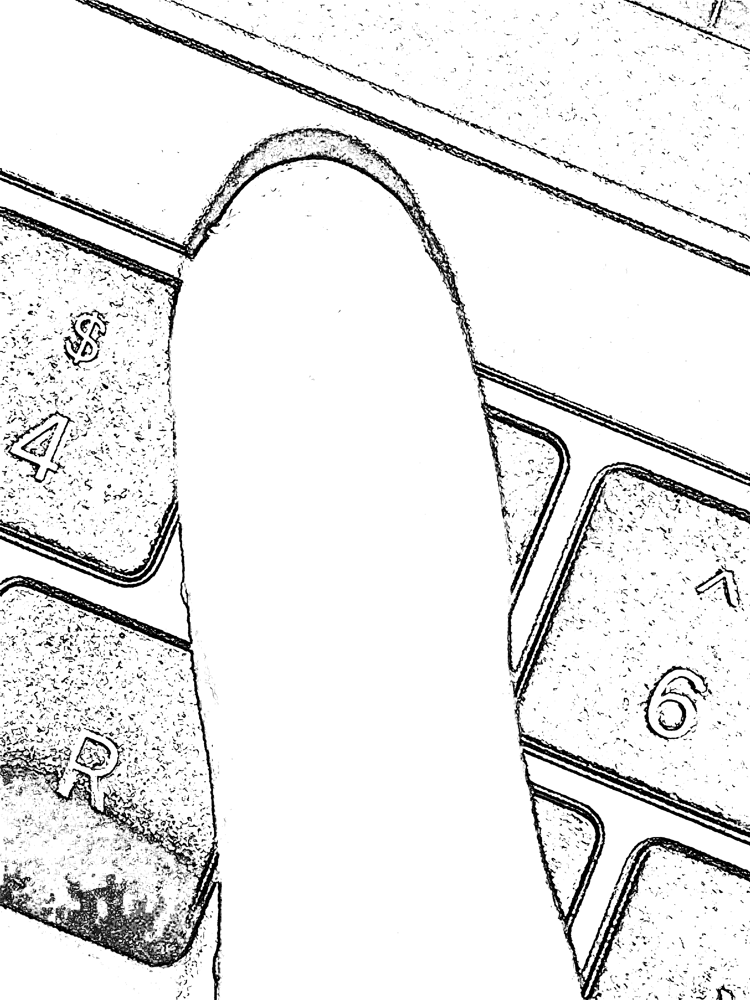

In [13]:
show(out_binary[1])

In [14]:
rnoise_image = cv2.GaussianBlur(bnw_img, (5, 5), 0)

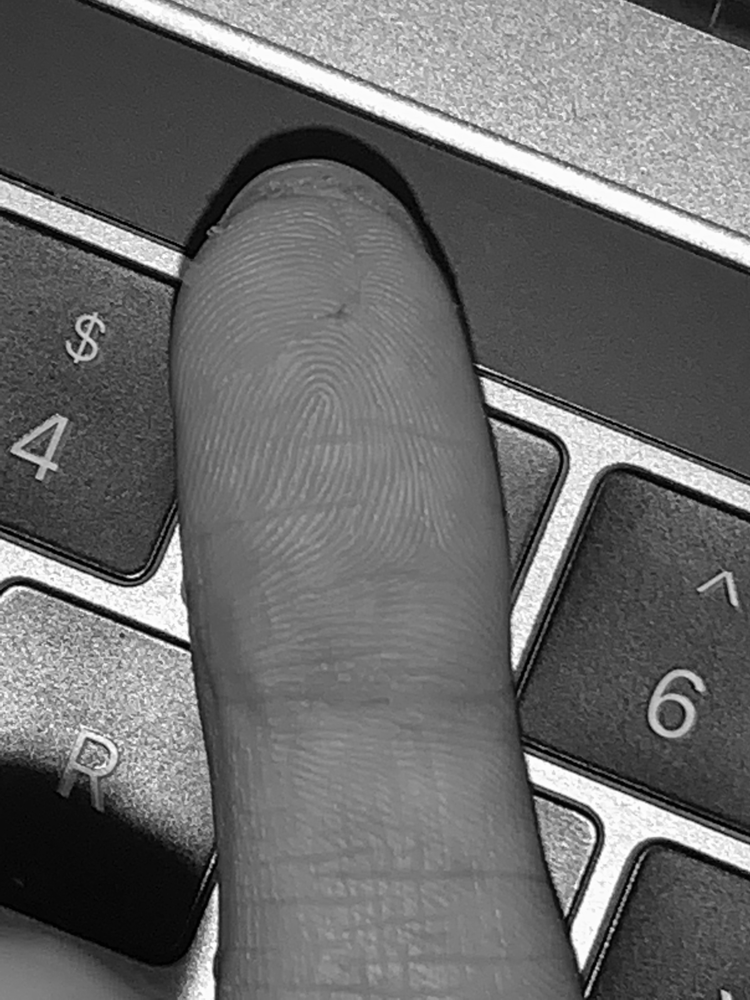

In [15]:
show(rnoise_image)

In [16]:
bins_num = 256

hist, bin_edges = np.histogram(rnoise_image, bins=bins_num)

hist = np.divide(hist.ravel(), hist.max())

bin_mids = (bin_edges[:-1] + bin_edges[1:]) / 2.

weight1 = np.cumsum(hist)
weight2 = np.cumsum(hist[::-1])[::-1]

mean1 = np.cumsum(hist * bin_mids) / weight1

mean2 = (np.cumsum((hist * bin_mids)[::-1]) / weight2[::-1])[::-1]

inter_class_variance = weight1[:-1] * weight2[1:] * (mean1[:-1] - mean2[1:]) ** 2

index_of_max_val = np.argmax(inter_class_variance)

threshold = bin_mids[:-1][index_of_max_val]
print("Otsu's algorithm implementation thresholding result: ", threshold)

Otsu's algorithm implementation thresholding result:  135.900390625


In [17]:
hist = cv2.calcHist([img],[0],None,[256],[0,256])

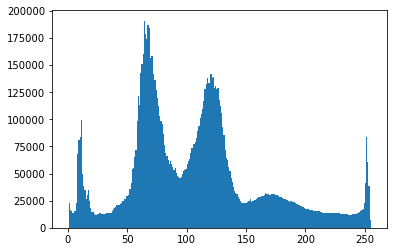

In [18]:
plt.hist(rnoise_image.ravel(),256,[0,256]); plt.show()

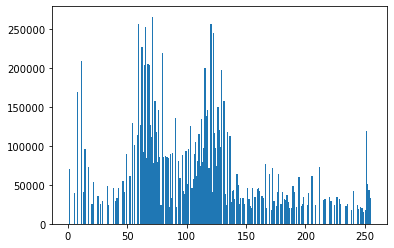

In [19]:
plt.hist(bnw_img.ravel(),256,[0,256]); plt.show()

In [20]:
ret, thresh1 = cv2.threshold(bnw_img, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)  

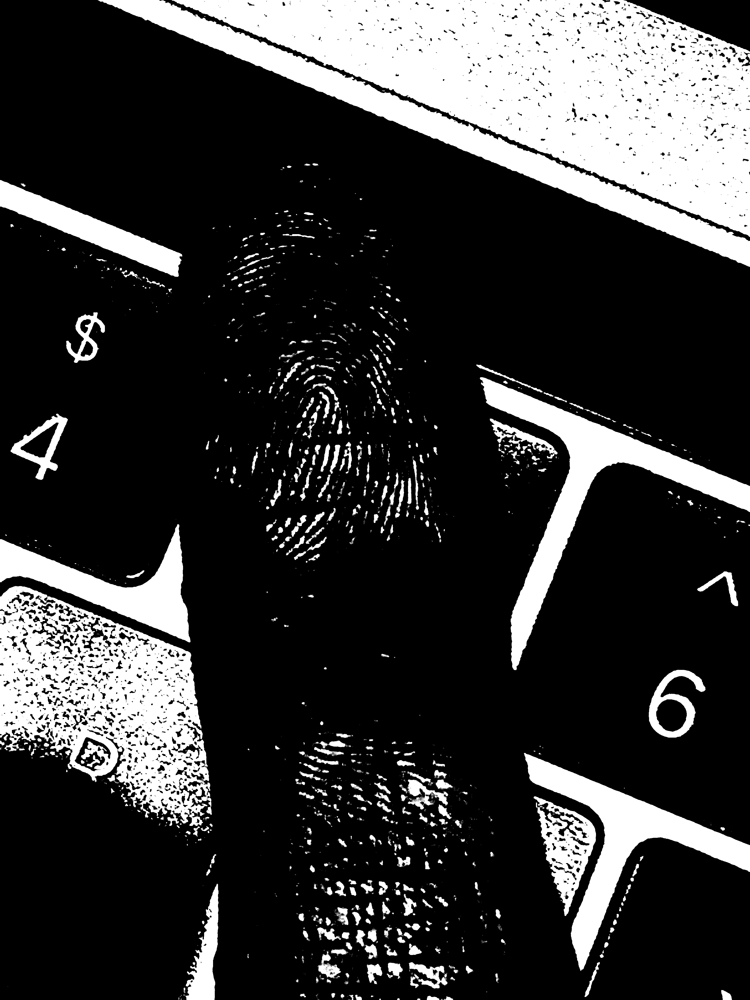

In [21]:
show(thresh1)

In [22]:
ret

136.0

In [23]:
def extractSkin(image):
    img = image.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)

    lower_threshold = np.array([0, 48, 80], dtype=np.uint8)
    upper_threshold = np.array([20, 255, 255], dtype=np.uint8)
    skinMask = cv2.inRange(img, lower_threshold, upper_threshold)


    skinMask = cv2.GaussianBlur(skinMask, (3, 3), 0)
    skin = cv2.bitwise_and(img, img, mask=skinMask)

    return cv2.cvtColor(skin, cv2.COLOR_HSV2BGR)


In [24]:
skin = extractSkin(img)

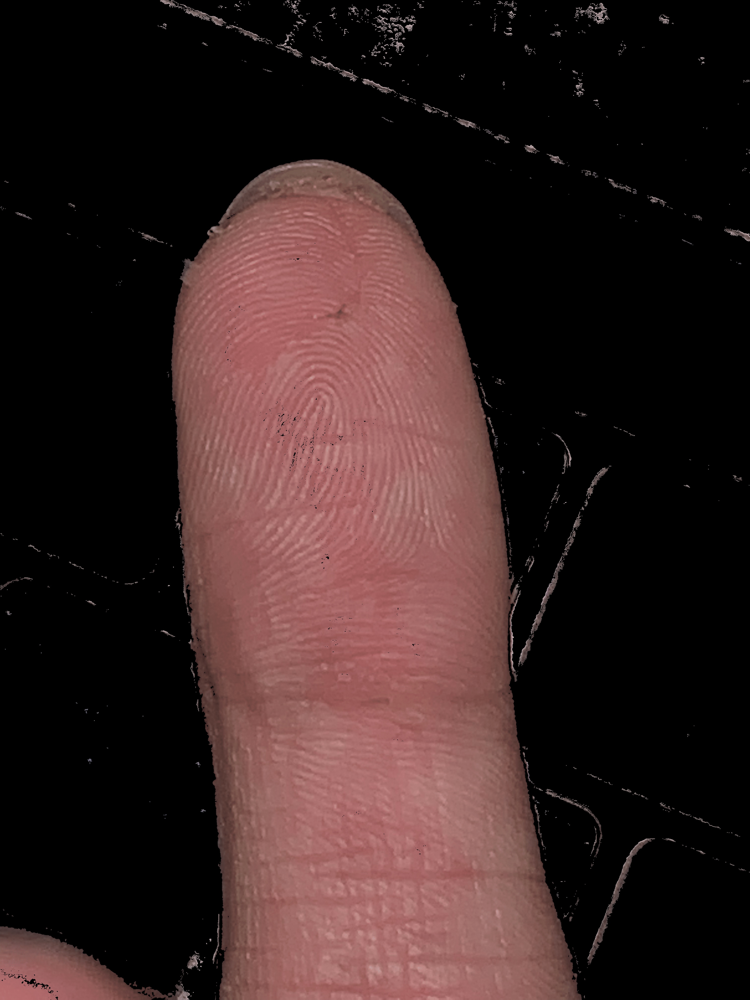

In [25]:
show(skin)

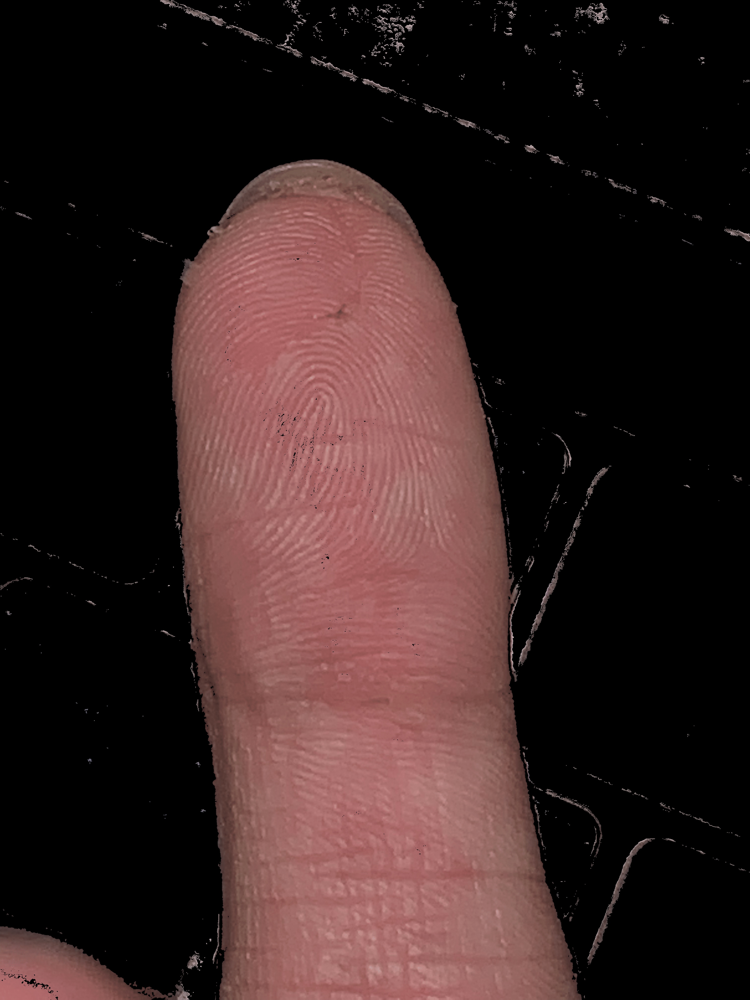

In [26]:
show(skin)